In [1]:
%load_ext autoreload
%autoreload 2

In [15]:
import numpy as np
import pandas as pd
import json
from typing import Union
import shapely
import scanpy as sc
import geopandas as gpd
from shapely.geometry import MultiPolygon
import spatialdata as sd
import os

from utility_functions.dissociated.pp.preprocessing import scwf
from utility_functions.spatial.ut.geopandas_utils import extract_polygon_coords
from amex_merfish_development._constants import *


In [3]:
DIR = GET_DATA_DIR('v1.0.2')
samples = ANNO_BASE.index
sample = samples[4]

[12/01/24 19:53:05] INFO     Accessing data directory: /nas/groups/treutlein/PROJECTS/axolotl/MERFISH/quant/v1.0.2

In [4]:
sdata = sd.read_zarr(DIR / sample / 'sdata.zarr')
adata = sdata['table']


In [19]:
class ShinyMerfish:
    
    def __init__(self, sample, input_path, output_path, metadata, **kwargs):

        self.sample = sample
        self.sdata = sd.read_zarr(input_path / self.sample / 'sdata.zarr')
        self.angle = metadata.loc[self.sample, 'angle'] + 180
        self.label = metadata.loc[self.sample, 'label']

        # Standard sc processing:
        self.sdata['table'] = scwf(self.sdata['table'], **kwargs).copy()

        # Define resolution keys and process data
        self._set_resolution_keys(kwargs)
        self._process_gdf()
        self._generate_traces()

        # Create output
        self._export(output_path)

    def _set_resolution_keys(self, kwargs: dict) -> None:
        """Set resolution keys for clustering based on provided resolutions or defaults."""
    
        resolutions = kwargs.get('resolutions') or inspect.signature(scwf).parameters['resolutions'].default
        self.resolution_keys = [f'leiden_{res}' for res in resolutions]

    def _process_gdf(self) -> None:
        """Process and rotate the gdf, adding clustering information from adata."""

        self.gdf = sd.match_element_to_table(
            sdata = self.sdata,
            element_name = "cell_boundaries",
            table_name = "table"
        )[0]["cell_boundaries"]

        self.gdf['x_center'] = self.gdf['geometry'].apply(lambda row : row.centroid.x)
        self.gdf['y_center'] = self.gdf['geometry'].apply(lambda row : row.centroid.y)

        shift_x = -round(np.mean(self.gdf['x_center']))
        shift_y = -round(np.mean(self.gdf['y_center']))

        self.gdf['geometry'] = self.gdf['geometry'].translate(xoff = shift_x, yoff = shift_y)
        self.gdf['geometry'] = self.gdf['geometry'].rotate(self.angle, origin=(0, 0))

        self.sdata['table'].obs['x'] = self.gdf['x_center']
        self.sdata['table'].obs['y'] = self.gdf['y_center']
        
        clustering_columns = self.sdata['table'].obs[self.resolution_keys]
        self.gdf = self.gdf.join(clustering_columns)

    def _generate_traces(self) -> None:
        """Generate trace data for each resolution key and store cell coordinates."""

        traces = {}
        for resolution in self.resolution_keys:
            cluster_dict = {}
            for cluster_id in np.unique(self.gdf[resolution]):
                cluster = self.gdf.loc[self.gdf[resolution] == cluster_id, 'geometry']
                cluster = cluster.geometry.buffer(3).union_all().buffer(-3)

                x_coords, y_coords = extract_polygon_coords(cluster)
                cluster_dict[cluster_id] = {'x': x_coords, 'y': y_coords}
                
            traces[resolution] = cluster_dict

        cells_x_coords, cells_y_coords = extract_polygon_coords(self.gdf['geometry'], simplify = 1)
        traces['cells'] = {'x': cells_x_coords, 'y': cells_y_coords}

        self.traces = traces

    def _export(self, output_path) -> None:

        with open(os.path.join(output_path, self.sample + '_traces.json'), 'w') as f:
            json.dump(self.traces, f)
            
        self.sdata['table'].write_h5ad(os.path.join(output_path, self.sample + '.h5ad'))

a = ShinyMerfish(sample,
                 DIR,
                 '../data',
                 ANNO_BASE,
                 normalize_to=800,
                 regress_out=['nCount_RNA'],
                 resolutions=[0.1, 0.2, 0.5, 1.0, 1.5],
                 n_umap=3,
                 basis='X_pca',
                 obs_keys=['nCount_RNA'])
a.traces

INFO     Removed 438 cells and 0 genes. Object now has shape 1915 cells x 500 genes.                               
INFO     PCA completed with 50 components.                                                                         
INFO     Neighbors computed with 15 neighbors.                                                                     
INFO     Clustering at resolution 0.1.                                                                             
INFO     Clustering at resolution 0.2.                                                                             
INFO     Clustering at resolution 0.5.                                                                             
INFO     Clustering at resolution 1.0.                                                                             
INFO     Clustering at resolution 1.5.                                                                             
INFO     UMAP computed with 3 dimensions.                               

/home/aabouelela/miniforge3/envs/amex_spatial/lib/python3.12/site-packages/spatialdata/_core/_elements.py:116: UserWarning: Key `table` already exists. Overwriting it in-memory.
  self._check_key(key, self.keys(), self._shared_keys)


{'leiden_0.1': {'0': {'x': [890.5035458351846,
    890.5,
    890.5,
    890.5035458351846,
    890.5520754914869,
    891.9479245085139,
    892.0014687330234,
    892.0736458663263,
    892.7573593128808,
    893.0514107338695,
    893.3426302789292,
    893.6282133446442,
    893.9054096099761,
    894.1715495233589,
    894.4240700119396,
    894.6605391653718,
    894.8786796564405,
    894.9479245085139,
    895.0014687330234,
    895.0736458663263,
    895.7573593128808,
    896.0514107338695,
    896.3426302789292,
    896.6282133446442,
    896.9054096099761,
    897.1715495233589,
    897.4240700119396,
    897.6605391653718,
    897.8786796564405,
    897.9479245085139,
    898.0,
    898.0520754914866,
    898.1338563717164,
    898.3683056930599,
    898.6236127895303,
    898.8969554555057,
    899.1853121172842,
    899.4854952340448,
    899.7941865334346,
    899.875869130757,
    899.998385451583,
    900.0520754914861,
    900.4479245085131,
    900.4964541648154,
  

In [6]:
a.sdata['table']

AnnData object with n_obs × n_vars = 1915 × 500
    obs: 'nCount_RNA', 'nFeature_RNA', 'area', 'eccentricity', 'perimeter', 'region', 'cell_id', 'n_counts', 'leiden_0.1', 'leiden_0.2', 'leiden_0.5', 'leiden_1.0', 'leiden_1.5'
    var: 'n_cells', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca', 'neighbors', 'leiden_0.1', 'leiden_0.2', 'leiden_0.5', 'leiden_1.0', 'leiden_1.5', 'umap'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [ ]:
class ShinyMerfish:
    """
    A class to process and visualize spatial data from MERFISH experiments with clustering and rotation transformations.
    
    Parameters:
        path (str): Path to the main directory containing spatial data.
        metadata_path (str): Path to the metadata CSV file.
        name (str): Identifier for the dataset.
    """

    def __init__(self,
                 path: str,
                 metadata_path: str,
                 output_path: str,
                 name: str,
                 **kwargs):
        
        self.name = name
        self.sdata = sd.read_zarr(os.path.join(path, self.name, 'sdata.zarr'))

        metadata = pd.read_csv(metadata_path, index_col=0)
        self.angle = metadata.loc[self.name, 'angle']
        self.label = metadata.loc[self.name, 'label']

        # Standard single-cell processing
        self.sdata['table'].obs['x'] = self.sdata['table'].obsm['spatial'][:, 0]
        self.sdata['table'].obs['y'] = self.sdata['table'].obsm['spatial'][:, 1]
        self.sdata['table'] = std_sc_wf(self.sdata['table'], **kwargs).copy()

        # Define resolution keys and process data
        self._set_resolution_keys(kwargs)
        self._process_gdf()
        self._generate_traces()

        # Create output
        #self._export()

    def _set_resolution_keys(self, kwargs: dict) -> None:
        """Set resolution keys for clustering based on provided resolutions or defaults."""
        
        resolutions = kwargs.get('resolutions') or inspect.signature(std_sc_wf).parameters['resolutions'].default
        self.resolution_keys = [f'leiden_{res}' for res in resolutions]

    def _process_gdf(self) -> None:
        """Process and rotate the gdf, adding clustering information from adata."""

        #self.gdf = join_spatialelement_table(
        #    sdata=self.sdata,
        #    spatial_element_names="cell_boundaries",
        #    table_name="table",
        #    how="right"
        #)[0]["cell_boundaries"].copy()

        self.gdf = sd.match_element_to_table(
            sdata = self.sdata,
            element_name = "cell_boundaries",
            table_name = "table"
        )[0]["cell_boundaries"]

        self.gdf['x_center'] = self.gdf['geometry'].apply(lambda row : row.centroid.x)
        self.gdf['y_center'] = self.gdf['geometry'].apply(lambda row : row.centroid.y)

        shift_x = -round(np.mean(self.gdf['x_center']))
        shift_y = -round(np.mean(self.gdf['y_center']))

        self.gdf['geometry'] = self.gdf['geometry'].translate(xoff = shift_x, yoff = shift_y)
        self.gdf['geometry'] = self.gdf['geometry'].rotate(self.angle, origin=(0, 0))

        self.sdata['table'].obs['x'] = self.gdf['x_center']
        self.sdata['table'].obs['y'] = self.gdf['y_center']
        
        clustering_columns = self.sdata['table'].obs[self.resolution_keys]
        self.gdf = self.gdf.join(clustering_columns)

    def _extract_polygon_coords(self,
                                polygonal_shapes: Union[gpd.GeoSeries, MultiPolygon],
                                simplify = False
                               ) -> tuple:
        """Extract x, y coordinates from polygon shapes, separating individual polygons with NaNs."""
        
        if isinstance(polygonal_shapes, MultiPolygon):
            # This is the case where more than one disconnected patches form the cluster
            polygonal_shapes = gpd.GeoSeries(polygonal_shapes.geoms)
        else:
            # This is the case where there is only one polygon forming the cluster
            polygonal_shapes = gpd.GeoSeries(polygonal_shapes)

        if simplify:
            polygonal_shapes = polygonal_shapes.apply(lambda poly: shapely.simplify(poly, simplify, preserve_topology = True))
        
        coords = polygonal_shapes.apply(lambda poly: poly.exterior.xy)
        x_coords = np.concatenate([np.append(xs, None) for xs, ys in coords])[:-1]
        y_coords = np.concatenate([np.append(ys, None) for xs, ys in coords])[:-1]

        return list(x_coords), list(y_coords)
               
    def _generate_traces(self) -> None:
        """Generate trace data for each resolution key and store cell coordinates."""

        traces = {}
        for resolution in self.resolution_keys:
            cluster_dict = {}
            for cluster_id in np.unique(self.gdf[resolution]):
                cluster = self.gdf.loc[self.gdf[resolution] == cluster_id, 'geometry']
                cluster = cluster.geometry.buffer(3).union_all().buffer(-3)
                #print(type(cluster))
                #print(f"{resolution} - {cluster_id}")

                x_coords, y_coords = self._extract_polygon_coords(cluster)
                cluster_dict[cluster_id] = {'x': x_coords, 'y': y_coords}
                
            traces[resolution] = cluster_dict

        cells_x_coords, cells_y_coords = self._extract_polygon_coords(
            self.gdf['geometry'], simplify = 1)
        traces['cells'] = {'x': cells_x_coords, 'y': cells_y_coords}

        self.traces = traces

    def _export(self) -> None:

        with open(os.path.join(output_path, self.label + 'traces.json'), 'w') as f:
            json.dump(self.traces, f)
            
        self.sdata['table'].write_h5ad(os.path.join(output_path, self.label + '.h5ad'))


In [17]:
metadata_path = '/nas/groups/treutlein/PROJECTS/axolotl/MERFISH/statistics/anno_extended.csv'
output_path = '/home/aabouelela/projects/amex_spatial/spaceolotl/data'
path = '/nas/groups/treutlein/PROJECTS/axolotl/MERFISH/quant/v1.0.2/'
name = '202302171205_region_0'

a = ShinyMerfish(path,
                 metadata_path,
                 output_path,
                 name,
                 normalize_to = 300,
                 regress_out = ['nCount_RNA', 'x', 'y'],
                 resolutions = [0.1, 0.2, 0.5, 1.0, 1.5],
                 n_umap = 3,
                 basis = 'X_pca',
                 obs_keys = ['nCount_RNA', 'x', 'y'])

INFO     Removed 438 cells and 0 genes. Object now has shape 1915 cells x 500 genes.                               
INFO     PCA completed with 50 components.                                                                         
INFO     Neighbors computed with 15 neighbors.                                                                     
INFO     Clustering at resolution 0.1.                                                                             
INFO     Clustering at resolution 0.2.                                                                             
INFO     Clustering at resolution 0.5.                                                                             
INFO     Clustering at resolution 1.0.                                                                             
INFO     Clustering at resolution 1.5.                                                                             
INFO     UMAP computed with 3 dimensions.                               

/home/aabouelela/miniforge3/envs/amex_spatial/lib/python3.12/site-packages/spatialdata/_core/_elements.py:116: UserWarning: Key `table` already exists. Overwriting it in-memory.
  self._check_key(key, self.keys(), self._shared_keys)


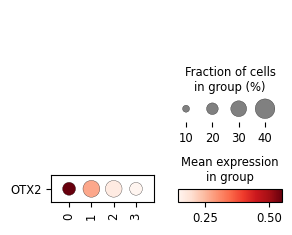

In [135]:
# Generate the DotPlot object
plot = sc.pl.dotplot(
    a.sdata['table'], 
    var_names='AMEX60DD011133-OTX2', 
    swap_axes=True, 
    #return_fig=True, 
    groupby='leiden_0.1',
    show = False
)

# Access the main plot axis
main_ax = plot['mainplot_ax']

# Extract current y-tick labels and modify them
y_axis_labels = [tick.get_text() for tick in main_ax.get_yticklabels()]
short_labels = [label.split("-")[-1] for label in y_axis_labels]

# Set the modified labels back to the y-axis
main_ax.set_yticklabels(short_labels)

# Show the updated plot
plt.show()


In [133]:
plot.get_axes()

AttributeError: 'dict' object has no attribute 'get_axes'

In [114]:
adata = a.sdata['table'].copy()
sc.tl.dendrogram(adata, groupby = 'leiden_0.1', key_added = 'leiden_0.1')
sc.tl.rank_genes_groups(adata, groupby = 'leiden_0.1', key_added = 'leiden_0.1')

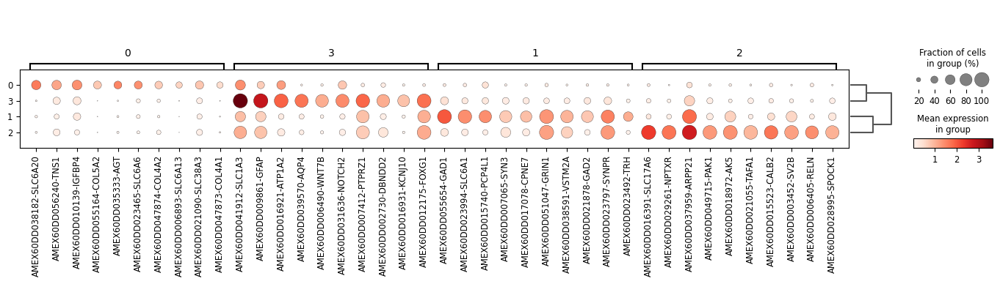

In [113]:
sc.pl.rank_genes_groups_dotplot(adata, key = 'leiden_0.1')

In [104]:
adata.uns['rank_genes_groups']

{'params': {'groupby': 'leiden_0.1',
  'reference': 'rest',
  'method': 't-test',
  'use_raw': True,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('AMEX60DD038182-SLC6A20', 'AMEX60DD055654-GAD1', 'AMEX60DD016391-SLC17A6', 'AMEX60DD041912-SLC1A3'),
            ('AMEX60DD056240-TNS1', 'AMEX60DD023994-SLC6A1', 'AMEX60DD029261-NPTXR', 'AMEX60DD009861-GFAP'),
            ('AMEX60DD010139-IGFBP4', 'AMEX60DD015740-PCP4L1', 'AMEX60DD037959-ARPP21', 'AMEX60DD016921-ATP1A2'),
            ('AMEX60DD055164-COL5A2', 'AMEX60DD007065-SYN3', 'AMEX60DD049715-PAK1', 'AMEX60DD039570-AQP4'),
            ('AMEX60DD035333-AGT', 'AMEX60DD017078-CPNE7', 'AMEX60DD018972-AK5', 'AMEX60DD006490-WNT7B'),
            ('AMEX60DD023465-SLC6A6', 'AMEX60DD051047-GRIN1', 'AMEX60DD021055-TAFA1', 'AMEX60DD031636-NOTCH2'),
            ('AMEX60DD047874-COL4A2', 'AMEX60DD038591-VSTM2A', 'AMEX60DD015523-CALB2', 'AMEX60DD007412-PTPRZ1'),
            ('AMEX60DD006893-SLC6A13', 'AMEX60DD021878-GA

In [64]:
a.metadata

AttributeError: 'ShinyMerfish' object has no attribute 'metadata'

In [2]:
from shapely.geometry import Polygon, MultiPolygon
from typing import Union

def extract_polygon_coords(gdf: gpd.geoseries.GeoSeries):

    x_coords = []
    y_coords = []
    
    # Setting index = False here returns a pandas dataframe
    # Unpacking tuples instead
    for _, geom in gdf.itertuples():
        
        # Extract exterior coordinates
        x, y = geom.exterior.xy
        
        # Append in bulk to avoid repeated list extension
        x_coords.extend(np.concatenate([x, [None]]))
        y_coords.extend(np.concatenate([y, [None]]))
    
    return x_coords, y_coords

def gpd_center_masks(gdf: gpd.GeoDataFrame, col: str):
    
    centroids = gdf[col].apply(lambda row : row.centroid)
    shift_x = round(np.mean(centroids.x))
    shift_y = round(np.mean(centroids.y))

    return gdf.translate(xoff = -shift_x, yoff = -shift_y)

def gpd_process_geometries(gdf: gpd.GeoDataFrame, col: str, angle: int):

    gdf[col] = gpd_center_masks(gdf, col)
    gdf[col] = gdf[col].rotate(angle, origin=(0,0))

    return gdf



In [5]:
a = batch_quantification(adata, obs_keys = ['nCount_RNA'], components  = [1,3,1])

INFO     Removed 446 cells and 0 genes. Object now has shape 3985 cells x 500 genes.                               
INFO     PCA completed with 50 components.                                                                         
INFO     Neighbors computed with 15 neighbors.                                                                     
INFO     UMAP computed with 2 dimensions.                                                                          
INFO     Correlation between "nCount_RNA" and component 1 of basis "X_pca" is 0.54.                                
INFO     Correlation between "nCount_RNA" and component 3 of basis "X_pca" is -0.11.                               
INFO     Correlation between "nCount_RNA" and component 1 of basis "X_pca" is 0.54.                                
INFO     Correlation between "nCount_RNA" and component 1 of basis "X_umap" is 0.03.                               
WARNING  Component 3 exceeds available components (2) in basis 'X_umap'.

In [47]:
a.rotate(60)
a.gdf['geometries_rot'].plot()

TypeError: ShinyMerfish.rotate() takes 1 positional argument but 2 were given

In [ ]:
def basic_process(adata,
                  scale=True,
                  regress_out=None,
                  n_neighbors=15, n_pcs=10,
                  keys=['n_counts', 'n_genes'],
                         bases=['pca', 'umap'],
                         components=[1, 2],
                         random_state=0, copy=True):

In [18]:


element_dict, table = join_spatialelement_table(
    sdata=sdata, spatial_element_names="cell_boundaries", table_name="table", how="right"
)

In [19]:
element_dict

{'cell_boundaries':                                                     geometry
 cell_3     POLYGON ((2438 239.5, 2437 239.5, 2436 239.5, ...
 cell_4     POLYGON ((2462 255.5, 2461 255.5, 2460 255.5, ...
 cell_11    POLYGON ((1018 538.5, 1017 538.5, 1016 538.5, ...
 cell_12    POLYGON ((1852 550.5, 1851 550.5, 1850 550.5, ...
 cell_13    POLYGON ((2176 558.5, 2175.5 558, 2175 557.5, ...
 ...                                                      ...
 cell_4422  POLYGON ((1427 2612.5, 1426 2612.5, 1425 2612....
 cell_4423  POLYGON ((1409 2614.5, 1408 2614.5, 1407 2614....
 cell_4424  POLYGON ((1419 2613.5, 1418 2613.5, 1417 2613....
 cell_4426  POLYGON ((1441 2666.5, 1440.5 2666, 1440 2665....
 cell_4431  POLYGON ((1043 2689.5, 1042.5 2689, 1042 2688....
 
 [3920 rows x 1 columns]}

In [20]:
table

AnnData object with n_obs × n_vars = 3920 × 500
    obs: 'nCount_RNA', 'nFeature_RNA', 'area', 'eccentricity', 'perimeter', 'region', 'cell_id', 'n_genes', 'leiden_0.1', 'leiden_0.2', 'leiden_0.5', 'leiden_1.0', 'leiden_1.5'
    uns: 'spatialdata_attrs', 'log1p', 'pca', 'neighbors', 'umap', 'leiden_0.1', 'leiden_0.2', 'leiden_0.5', 'leiden_1.0', 'leiden_1.5'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

<Axes: >

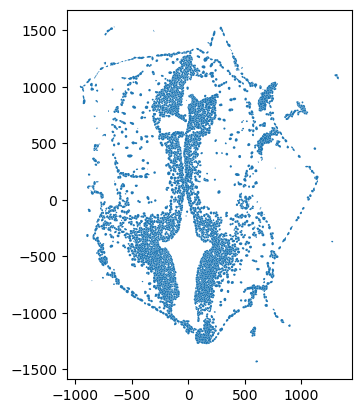

In [38]:
# Create the pandas GeoDataFrame
angle = 100

# Filter for cells that are only in the adata object
gdf = gpd.GeoDataFrame(sdata['cell_boundaries']['geometry'])
gdf['cell_id'] = gdf.index
gdf = gdf[gdf['cell_id'].isin(adata.obs['cell_id'])]

# Shift the masks to the center
gdf = gpd_process_geometries(gdf, 'geometry', angle)

# Add more metadata
gdf = pd.concat([gdf.reset_index(drop=True), gpd.GeoDataFrame(adata.obs.iloc[:, 8:14]).reset_index(drop=True)], axis=1)

gdf.plot()

In [39]:
# Add the centroids to adata
adata.obs['x'] = np.array(gdf.geometry.centroid.x)
adata.obs['y'] = np.array(gdf.geometry.centroid.y)

# Generate the trace information
resolutions = ['leiden_0.1', 'leiden_0.2', 'leiden_0.5', 'leiden_1.0', 'leiden_1.5']

traces = {}
for resolution in resolutions:
    
    cluster_dict = {}
    
    for cluster_id in np.unique(gdf[resolution]):
        
        cluster = gpd.GeoSeries(gdf.loc[gdf[resolution] == cluster_id, 'geometry'])
        cluster = cluster.geometry.buffer(1).union_all().buffer(-1)
        cluster = gpd.GeoDataFrame(list(cluster.geoms))

        x, y = extract_polygon_coords(cluster)
        cluster_dict[cluster_id] = {'x': x, 'y': y}

    traces[resolution] = cluster_dict

cells_x_coords, cells_y_coords = extract_polygon_coords(gpd.GeoDataFrame(gpd.GeoSeries(gdf['geometry']).geometry))

traces['cells'] = {'x': cells_x_coords, 'y': cells_y_coords}

In [40]:
with open('data' + '/' + name + 'traces.json', 'w') as f:
    json.dump(traces, f)

adata.write_h5ad('data' + '/' + name + '.h5ad')
#gdf.to_file('data' + '/' + name + '.shp')

In [11]:
np.save("genes.npy", np.array(adata.var_names))

In [14]:
adata.obsm['X_umap']

array([[-7.639843 , -2.0576868],
       [16.116995 ,  4.5577865],
       [12.370062 ,  9.682994 ],
       ...,
       [11.5596075, 10.791188 ],
       [15.4556465,  4.2226624],
       [14.95539  ,  3.9866555]], dtype=float32)

In [260]:
import plotly.graph_objects as go

fig = go.Figure()

for cluster_id in np.unique(adata.obs['leiden_0.1']):
    
    cluster = gpd.GeoSeries(adata.obs.loc[adata.obs['leiden_0.1'] == cluster_id, 'geometry'])
    cluster = cluster.geometry.buffer(20).union_all().buffer(-20)
    cluster = gpd.GeoDataFrame(list(cluster.geoms))

    x_coords, y_coords = extract_polygon_coords(cluster)
    fig.add_trace(go.Scatter(x = x_coords, y = y_coords, fill = 'toself', mode = 'lines', line=dict(width=1)))

import chart_studio.plotly as py

ModuleNotFoundError: No module named 'chart_studio'

In [262]:
from plotly.offline import init_notebook_mode, iplot

In [1]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()

import numpy as np
np.random.seed(1)

# Generate data
x0 = np.random.normal(2, 0.45, 300)
y0 = np.random.normal(2, 0.45, 300)

x1 = np.random.normal(6, 0.4, 200)
y1 = np.random.normal(6, 0.4, 200)

# Create figure
fig = go.Figure()

# Add scatter traces
fig.add_trace(go.Scatter(x=x0, y=y0, mode="markers"))
fig.add_trace(go.Scatter(x=x1, y=y1, mode="markers"))

# Add shapes
fig.add_shape(type="circle",
    xref="x", yref="y",
    x0=min(x0), y0=min(y0),
    x1=max(x0), y1=max(y0),
    opacity=0.2,
    fillcolor="blue",
    line_color="blue",
)

fig.add_shape(type="circle",
    xref="x", yref="y",
    x0=min(x1), y0=min(y1),
    x1=max(x1), y1=max(y1),
    opacity=0.2,
    fillcolor="orange",
    line_color="orange",
)


# Hide legend
fig.update_layout(showlegend=False)

fig.show()

In [72]:
#gdf.to_file('test.shp', index = False)
gdf = gpd.read_file('test.shp', columns='geometry')

<Axes: >

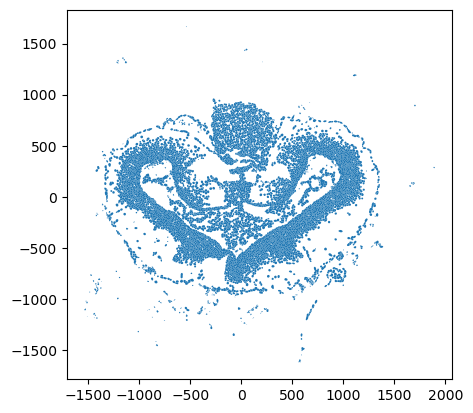

In [99]:
gdf.geometry.rotate(127, origin=(0,0)).plot()

In [71]:
import shapely
for index, row in gdf.iterrows():
    rotated = shapely.affinity.rotate(row, 200)

    gdf.loc[index] = rotated

AttributeError: 'Series' object has no attribute 'is_empty'

<Axes: >

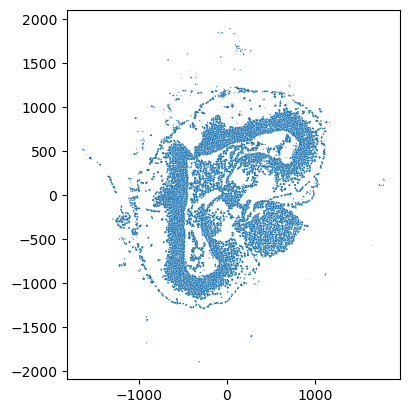

In [60]:
gdf.plot()

In [55]:
res

In [31]:
def extract_polygon_coords(gdf: gpd.geoseries.GeoSeries):

    x_coords = []
    y_coords = []
    
    # Setting index = False here returns a pandas dataframe
    # Unpacking tuples instead
    for _, geom in gdf.itertuples():

        print(geom)
        break
        
        # Extract exterior coordinates
        x, y = geom.exterior.xy
        
        # Append in bulk to avoid repeated list extension
        x_coords.extend(np.concatenate([x, [None]]))
        y_coords.extend(np.concatenate([y, [None]]))
    
    return x_coords, y_coords

In [32]:
%time
bla = extract_polygon_coords(test)


CPU times: user 10 µs, sys: 1 µs, total: 11 µs
Wall time: 20.7 µs
POLYGON ((-310 -1889.5, -309.5 -1890, -309 -1890.5, -308 -1890.5, -307 -1890.5, -306.5 -1891, -306 -1891.5, -305 -1891.5, -304.5 -1892, -304.5 -1893, -304 -1893.5, -303.5 -1894, -303 -1894.5, -302.5 -1895, -303 -1895.5, -303.5 -1896, -303.5 -1897, -303.5 -1898, -303.5 -1899, -303.5 -1900, -303.5 -1901, -304 -1901.5, -304.5 -1902, -305 -1902.5, -305.5 -1903, -306 -1903.5, -307 -1903.5, -308 -1903.5, -308.5 -1904, -309 -1904.5, -310 -1904.5, -311 -1904.5, -312 -1904.5, -312.5 -1904, -313 -1903.5, -314 -1903.5, -315 -1903.5, -315.5 -1903, -316 -1902.5, -316.5 -1902, -317 -1901.5, -317.5 -1901, -317.5 -1900, -317.5 -1899, -318 -1898.5, -318.5 -1898, -318.5 -1897, -318 -1896.5, -317.5 -1896, -317.5 -1895, -317.5 -1894, -317 -1893.5, -316.5 -1893, -316.5 -1892, -316 -1891.5, -315.5 -1891, -315 -1890.5, -314 -1890.5, -313 -1890.5, -312.5 -1890, -312 -1889.5, -311 -1889.5, -310 -1889.5))


/home/aabouelela/miniforge3/envs/amex_spatial/lib/python3.12/site-packages/geopandas/geoseries.py:720: FutureWarning:

Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`



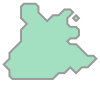

In [92]:
sdata['cell_boundaries']['geometry'][5]

In [63]:
sdata['cell_boundaries']

,geometry
cell_1,"POLYGON ((1340 166.5, 1339 166.5, 1338 166.5, ..."
cell_2,"POLYGON ((744 379.5, 743 379.5, 742 379.5, 741..."
cell_3,"POLYGON ((1923 450.5, 1922 450.5, 1921.5 450, ..."
cell_4,"POLYGON ((1939 467.5, 1938 467.5, 1937 467.5, ..."
cell_5,"POLYGON ((739 628.5, 738 628.5, 737 628.5, 736..."
...,...
cell_7573,"POLYGON ((1555 3907.5, 1554 3907.5, 1553 3907...."
cell_7574,"POLYGON ((1568 3921.5, 1567 3921.5, 1566 3921...."
cell_7575,"POLYGON ((1696 3934.5, 1695 3934.5, 1694 3934...."
cell_7576,"POLYGON ((1688 3950.5, 1687 3950.5, 1686.5 395..."
